In [5]:
#Obtain variable names

import pandas as pd # import libraries
import netCDF4 # import libraries

base_dir = r'C:\Users\elchi\Desktop\UIC_Chicago\Knowledge_graph\Backend'

file1=base_dir + r'\RAIN.nc' # Daily total Precipitation (mm)
file2=base_dir + r'\HI.nc' # Heat Index (F°)
file3=base_dir + r'\RH2.nc' # Relative Humidity at 2M (%)
file4=base_dir + r'\T2.nc' # Temperature at 2 Meters (K°)
file6=base_dir + r'\WDIR10.nc' # Wind Direction Speed direction at 10 Meters (degrees)
file7=base_dir + r'\WSPD10.nc' # Wind Speed Wind speed at 10 Meters (m/s)
dt1 = netCDF4.Dataset(file1)
dt2 = netCDF4.Dataset(file2)
dt3 = netCDF4.Dataset(file3)
dt4 = netCDF4.Dataset(file4)

dt6 = netCDF4.Dataset(file6)
dt7 = netCDF4.Dataset(file7)

rain_var_name = list(dt1.variables.keys())[0]
hi_var_name = list(dt2.variables.keys())[0]
rh2_var_name = list(dt3.variables.keys())[0]
t2_var_name = list(dt4.variables.keys())[0]
wdir10_var_name = list(dt6.variables.keys())[0]
wspd10_var_name = list(dt7.variables.keys())[0]

#The variable name is the name of the file

print("Variable names for Daily total Precipitation (mm): " + str(rain_var_name)) # RAIN
print("Variable names for Heat Index (F°): " + str(hi_var_name)) # HI
print("Variable names for Relative Humidity at 2M (%): " + str(rh2_var_name)) # RH2
print("Variable names for Temperature at 2M (K°): " + str(t2_var_name)) # T2
print("Variable names for Wind Direction Speed direction at 10 Meters (degrees): " + str(wdir10_var_name)) # WDIR10
print("Variable names for Wind Speed Wind speed at 10 Meters (m/s): " + str(wspd10_var_name)) # WSPD10
print("Variable names for latitude and longitude: " + str(list(dt1.variables.keys())[1]) + ", " + str(list(dt1.variables.keys())[2])) # lat, lon

print(dt6[str(wdir10_var_name)])
print(dt7[str(wspd10_var_name)])

Variable names for Daily total Precipitation (mm): RAIN
Variable names for Heat Index (F°): HI
Variable names for Relative Humidity at 2M (%): RH2
Variable names for Temperature at 2M (K°): T2
Variable names for Wind Direction Speed direction at 10 Meters (degrees): WDIR10
Variable names for Wind Speed Wind speed at 10 Meters (m/s): WSPD10
Variable names for latitude and longitude: XLAT, XLONG
<class 'netCDF4.Variable'>
float32 WDIR10(Time, south_north, west_east)
    FieldType: 104
    MemoryOrder: XY 
    description: 10 meter wind direction
    units: degrees
    coordinates: XLONG XLAT XTIME
    stagger: 
    cell_methods: Time: mean
unlimited dimensions: Time
current shape = (49, 668, 443)
filling on, default _FillValue of 9.969209968386869e+36 used
<class 'netCDF4.Variable'>
float32 WSPD10(Time, south_north, west_east)
    FieldType: 104
    MemoryOrder: XY 
    description: 10 meter wind speed
    units: m/s
    coordinates: XLONG XLAT XTIME
    stagger: 
    cell_methods: Time:

In [50]:

# Feel free to skip this file if you want to do a manual exploration
# Obtain the set of files which have the most extreme values
# This is to try and find the most interesting weather events
import os
import netCDF4 as nc
import numpy as np
from collections import defaultdict

max_vals = []

base_dir = r'C:\Users\elchi\Desktop\UIC_Chicago\Knowledge_graph\Backend\try_clean'

#base_dir = r'G:\Data_forecast'


for date_folder in os.listdir(base_dir):
    date_path = os.path.join(base_dir, date_folder)
    if os.path.isdir(date_path):  # only YYYYMMDD
        for run_folder in os.listdir(date_path):
            run_path = os.path.join(date_path, run_folder)
            outputs_path = os.path.join(run_path, "outputs")

            if os.path.isdir(outputs_path):  # only if outputs exists
                # print(f"\n📂 Checking folder: {outputs_path}")
                for file in os.listdir(outputs_path):
                    if file.endswith(".nc") and (file == "RAIN.nc" or file == "WSPD10.nc"): # Well only check for rain and windspeed
                        file_path = os.path.join(outputs_path, file)
                        
                        try:
                            with nc.Dataset(file_path, "r") as ds:
                                # Check a specific variable (e.g., RAIN)
                                data = ds.variables[file[:-3]][:]
                                
                                min_val = np.min(data)
                                max_val = np.max(data)


                                max_vals.append([file,outputs_path,max_val-min_val])
                                # print(f"{file} → min={min_val}, max={max_val}")
                        except Exception as e:
                            print(f"Error reading {file}: {e}")


# Use dict to find max per type
max_per_type = defaultdict(lambda: [None, None, -np.inf]) 

for file, path, diff in max_vals:
    if diff > max_per_type[file][2]:
        max_per_type[file] = [file, path, diff]


for file_type, info in max_per_type.items():
    """
    Result example: Largest difference for RAIN.nc: 207.6842041015625 in time 20250626 and timezone t00z
    Use 20250626 and t00z to explore other files not yet explored.
    """
    print(f"Largest difference for {file_type}: {info[2]} in time {info[1][-21:-13]} and timezone {info[1][-12:-8]}")
    # the result should be something like this
    # Largest difference for RAIN.nc: 207.6842041015625 in time 20250626 and timezone t00z
    # Largest difference for WSPD10.nc: 27.16493034362793 in time 20250629 and timezone t12z
    
    

Largest difference for RAIN.nc: 207.6842041015625 in time 20250626 and timezone t00z
Largest difference for WSPD10.nc: 27.16493034362793 in time 20250629 and timezone t12z


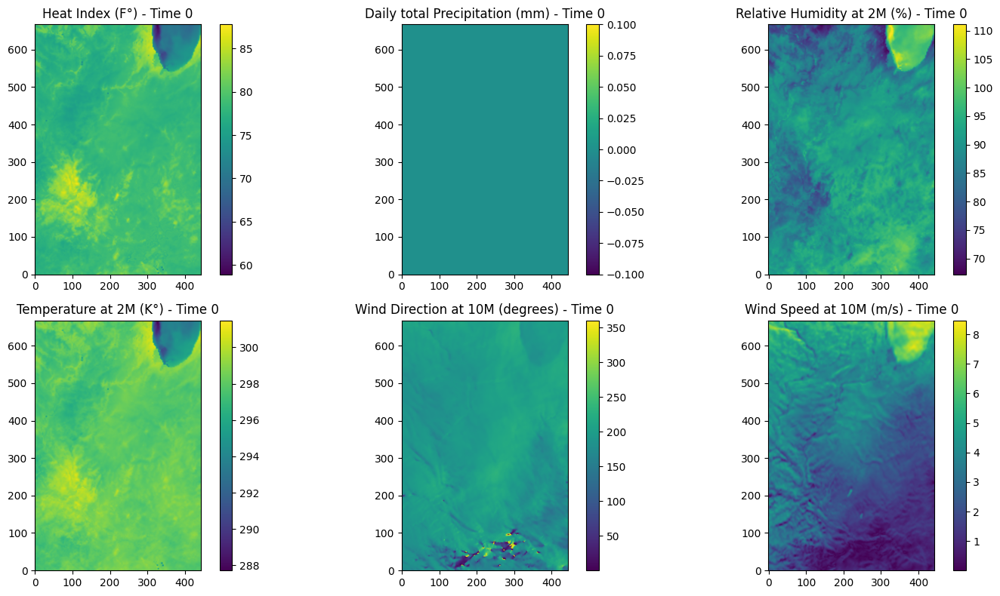

In [3]:
import os
import netCDF4 as nc
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np
import matplotlib as mpl
# Enable interactive backend for Jupyter
# %matplotlib notebook  # or %matplotlib widget

mpl.rcParams['animation.embed_limit'] = 50 * 1024**2  # 50 MB for animation

# Modify the date and timezone
date = '20250623'
timezone = "t12z"  # Either t00z or t12z

base_path = rf'C:\Users\elchi\Desktop\UIC_Chicago\Knowledge_graph\Backend\try_clean\{date}\{timezone}\outputs'
#base_path = rf'G:\Data_forecast\{date}\{timezone}\outputs'


# Gather all .nc files
nc_files = []
for root, dirs, files in os.walk(base_path):
    for file in files:
        if file.endswith(".nc"):
            nc_files.append(os.path.join(root, file))


batch_size = 6  # number of graphs per batch

for batch_start in range(0, len(nc_files), batch_size):
    batch = nc_files[batch_start:batch_start+batch_size]
    n_files = len(batch)
    cols = 3
    rows = int(np.ceil(n_files / cols))

    fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 4*rows))
    axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

    images = []
    data_list = []
    titles = []

    name_map = {
        "HI": "Heat Index (F°)",
        "RAIN": "Daily total Precipitation (mm)",
        "RH2": "Relative Humidity at 2M (%)",
        "T2": "Temperature at 2M (K°)",
        "WDIR10": "Wind Direction at 10M (degrees)",
        "WSPD10": "Wind Speed at 10M (m/s)"
    }

    for i, file_path in enumerate(batch):
        dataset = nc.Dataset(file_path)
        var_name = os.path.basename(file_path)[:-3]  # remove ".nc"
        if var_name in dataset.variables:
            data = dataset.variables[var_name][:]  # shape (time, lat, lon)
            data_list.append(data)
            im = axes[i].imshow(data[0, :, :], origin='lower', cmap='viridis')
            axes[i].set_title(name_map.get(var_name, var_name))
            fig.colorbar(im, ax=axes[i])
            images.append(im)
            titles.append(name_map.get(var_name, var_name))
        else:
            print(f"Variable {var_name} not found in {file_path}")
            data_list.append(None)
            images.append(None)
            titles.append(name_map.get(var_name, var_name))

    # Hide unused subplot slots
    for j in range(i+1, len(axes)):
        axes[j].axis("off")

    # Animation update function
    def update(frame):
        for idx, data in enumerate(data_list):
            if data is not None:
                images[idx].set_array(data[frame % data.shape[0], :, :])
                axes[idx].set_title(f"{titles[idx]} - Time {frame}")
        return images

    ani = FuncAnimation(
        fig, update,
        frames=max([d.shape[0] for d in data_list if d is not None]),
        interval=200, blit=False
    )

    ani.embed_limit = 50

    # Uncomment to save the animation as a GIF file (optional)
    ani.save("rain_animation.gif", writer="pillow", fps=5)

    plt.tight_layout()
    display(HTML(ani.to_jshtml()))  # show animation inline in Jupyter


In [ ]:
# Promising Dates and timezoes

"""
20250623 - t12z - t00z

20250630 - t12z - t00z around frame 35

20250706  - t00z

20250706  - t00z First couple of frames - t12z <- One of the best ones

20250710  - t00z <- Good patch of rain over the same place - t12z <- the same as t00z but even better, also one of the best ones

20250712 - t12z Usable

20250713 - t12z Usable

20250720 - t12z very heavy rain

"""


'\n20250623 - t12z - t00z\n\n\n\n'